<a href="https://colab.research.google.com/github/jmcardenas8/Certificados/blob/main/Mecanica-de-medios-continuos/MCON_Tarea1_ModeloNumericoDeUnGas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<p>
<img src="https://drive.google.com/uc?id=1ZHUKcwzA5c-PKUwoGmBG3TsHk6TmZ-Y0" align="left" width="250">
</p>

<p>
<h1><b><center>Mecánica de Medios Continuos</center></b></h1>
<h2><b><center>Prof. Jorge I. Zuluaga</center></b></h1>
<h2><b><center>Tarea 1</center></b><h2>
<h3><b><center>Modelo numérico de un gas</center></b><h3>
<h5><center><b>Asignada</b>: 9 de Febrero de 2024</center><h5>
<h5><center><b>Entrega</b>: 23 de Febrero de 2024</center><h5>
</p>

<hr/>
<b>Nombre</b>: Juan Manuel Cardenas
<br/>
<b>Cédula</b>: 1002587562
<br/>
<b>Última actualización</b>:22/2/24
<hr/>

In [ ]:
# Instalacion de librerias
!pip install -q celluloid # animaciones

In [ ]:
# Librerias
import numpy as np
import matplotlib.pyplot as plt
import scipy.constants as cts
import pandas as pd

from tqdm import tqdm # control de tiempos
from celluloid import Camera # animacion 2d
from IPython.display import HTML # visualizar animacion 2d
from matplotlib.patches import Circle # graficar circulos 2d
from matplotlib.collections import PatchCollection # grafica objetos 2d

from matplotlib import rc # run and config animacion 3d
from matplotlib import animation # animacion 3d
from mpl_toolkits.mplot3d import Axes3D # graficas 3d

###**Objetivo**:
El objetivo de esta tarea es implementar la teoría básica vista en clase para un gas ideal y simular el comportamiento de del gas, verificando las relaciones que existen entre las propiedades microscópicas y macroscópicas del mismo.

### **Procedimiento**:





## **Unidades Canonicas Termodinamicas**

1. Definir un sistema apropiado de unidades termodinámicas, tal que $k_B=1$, es decir, después de fijar 3 de las unidades básicas, encuentre la unidad faltante. Explique bien sus elecciones.

Fijada la constante de boltzmann en 1, se buscó encontrar la unidad canonica de tiempo asociada para dimensionalzar la escala de tiempo empleada por la simulacion las particulas, por lo que las demas unidades involucradas en la constante de boltzmann se fijaron.

$$[K_b] = [J/K] = [\frac{kg*m^{2}}{s^{2}K}]$$ <br>

Para la **Unidad de Masa** se escogió la unidad atomica de masa $U_m = 1 Da$, misma masa que se definio para las particulas, simulando atomos de Hidrogeno
<br>

Para la **Unidad de Longitud**, debido a que el lado del cubo contenedor debia medir 10 [$U_l$], se decidió tomar la unidad de longitud tal que contenga 10 veces el [radio medio del atomo de Hidrogreno](https://ptable.com/?lang=es#Is%C3%B3topos/Count) $U_l = 10 R_H$ con $R_H = 25$ [pm]  <br>

Para La **Unidad de Temperatura** se tomó una relativamente cercana a temperatura ambiente, como $U_T = 300 K $




In [ ]:
# Constantes importantes
K_b = cts.Boltzmann # cte boltzmann [J/K mol] = [ kg m^2/ s^2 K mol]
R_H = 25e-12        # radio medio hidrogeno [m]

# Unidades canonicas
U_m = cts.u         # unidad de masa 1 Dalton [kg]
U_l = 10*R_H        # unidad longitud [m]
U_T = 300           # unidad de temperatura [K]
U_t = U_l*( U_m/(U_T*K_b) )**0.5 # unidad de tiempo [s]

# Unidades derivadas
U_v = U_l/U_t       # unidad de velocidad
N_a  = 1            # numero de avogadro [mol]
Kb_canon = K_b/(U_m*U_l**2/(U_t**2*U_T)) # cte boltzmann fijada a 1
R_ideal = R_H/U_l # radio ideal de las particulas [U_l]

print(f'Unidad canonica de tiempo {U_t} [s] = {U_t*1e12:.5f} [ps]')

Unidad canonica de tiempo 1.5829321092593387e-13 [s] = 0.15829 [ps]


## **Generacion de Particulas**

2. Generar posiciones al azar para $N$ partículas de un gas dentro de una caja cúbica de lado $L=10$ (en unidades termodinámicas). Comience, para hacer pruebas, con un número pequeño de partícula $N=100$ y vaya aumentando para mejorar los resultados.

La eleccion del numero de particulas $N$ se vio condicionada en un alto grado por el tiempo de computo para la evolucion de todo el sistema como se verá mas adelante.

In [ ]:
# Parametros importantes
N = 300    # numero de particulas
L = 10     # lado del cubo [U_l]
g = 3      # grados de libertad
V = L**g   # volumen total [U_l^g]

# distribucion de particulas
pos = np.random.uniform(0+R_ideal, L-R_ideal, size=(N,g))

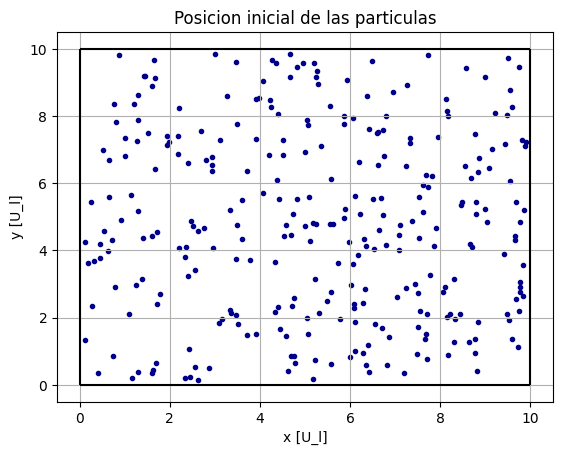

In [ ]:
plt.title('Posicion inicial de las particulas')
plt.scatter( pos[:,0], pos[:,1], marker='.', color='darkblue')
plt.vlines(0, 0,10, 'k')
plt.vlines(10, 0,10, 'k')
plt.hlines(0, 0,10, 'k')
plt.hlines(10, 0,10, 'k')
plt.xlabel('x [U_l]')
plt.ylabel('y [U_l]')
plt.grid()
plt.show()

## **Generacion de velocidades**

3. Escoger una temperatura inicial para el gas $T$ y una masa para las partículas $m_A$. Calcule $v_{mol}$ y genere con ella los vectores velocidad de las partículas de modo que sus componentes rectangulares sigan la prescripción de Boltzmann, a saber, cada componente se distribuye normalmente, con media 0 y desviación estándar igual a $\sigma= \sqrt{K_b T/m_a}$ (para todas las componentes).

> **NOTA**: Para generar números distribuídos gausianamente se puede usar la rutina: np.random.normal así: `np.random.normal(loc=0,scale=0.8, size=100)` genera 100 números distribuídos normalmente con media $\mu=0$ y desviación estándar $\sigma=0.8$.

<br>

Teniendo en cuenta:

 $$ v_{mol} = \sqrt{\frac{g R_{mol}T}{M_{mol}}}$$

In [ ]:
# Condiciones iniciales y otros parametros
T = 1                  # temperatura inicial [U_T]
m_a = 1                # masa de las particulas [U_m]
v_mol = (g*Kb_canon*T/m_a)**0.5 # [U_v]

V_mol = V / N          # volumen molar
L_mol = (V_mol)**(1/3) # lado molar
M = m_a * N            # masa total [U_m]


# Distribucion normal en componentes de velocidades
media = 0
desv = (Kb_canon*T/m_a)**0.5          # desviacion estandar

vel = np.random.normal( loc=media, scale=desv, size=(N,g) )
rapid = np.linalg.norm(vel, axis = 1) # rapideces


## **Densidades**

4. Una vez inicializadas las posiciones y las velocidades, calcular *numéricamente* en toda la caja: <br>
a) la densidad de número de las partículas, <br>
b) la densidad de masa, <br>
c) la densidad de energía cinética. <br><br>

##### **Densidades Globales**

Empleando las relaciones de la mecanica estadistica se calcularon las densidades para el volumen total

In [ ]:
n = N/V      # densidad de numero de particulas
rho = m_a*n  # densidad de masa
densidad_k = rho*(np.mean(rapid**2))/2 # densidad n<k>

print(f'Densidad de Numero: n = {n} ') # [1/U_L^3]
print(f'Densidad de Masa: ρ = {rho} ') # [U_m/U_L^3]
print(f'Densidad de Energia Cinetica: n<k>={densidad_k:.5f}')#[U_m/(U_L*U_t^2)]

Densidad de Numero: n = 0.3 
Densidad de Masa: ρ = 0.3 
Densidad de Energia Cinetica: n<k>=0.44878


##### **Densidades en volumenes de control**

Se creó una malla $3d$ con subcubos de lado $dl = 2 [U_l]$ dentro del volumen total, y con las condiciones iniciales dentro de cada uno de los subvolumenes se calcularon las densidades de numero, masa y energia cinetica para cada uno. Posteriormente se obtuvo el promedio asociado a cada una. Para encontrar las particulas dentro de un volumen de control se realizó mediante mascaras booleanes (boolean mask)

In [ ]:
# parametros volumenes de
dl = 2              # lado de los volumenes de control [U_l]
vol_mic = dl**g     # volumen de control [U_l^3]

n_mic = []          # densidad de numero
rho_mic = []        # densidad de masa
partis_mic = []     # particulas en volumen de control
densidad_k_mic = [] # densidad de energia cinetica



# particulas [x,y,z,vx,vy,vz]
parti = np.array([pos[:,0], pos[:,1], pos[:,2],
                  vel[:,0], vel[:,1], vel[:,2]]).T


# Barriendo sobre todos los volumenes de control
for k in range(int(L/dl)): # en z
  for j in range(int(L/dl)): # en y
    for i in range(int(L/dl)): # en x

      # particulas internas al volumen de control (boolean mask)
      parti_mic = parti[(i*dl < parti[:,0]) & (parti[:,0] < (i+1)*dl) & # x
                        (j*dl < parti[:,1]) & (parti[:,1] < (j+1)*dl) & # y
                        (k*dl < parti[:,2]) & (parti[:,2] < (k+1)*dl) ] # z

      n_i = len(parti_mic)/vol_mic  # densidad de numero
      rho_i = m_a*n_i               # densidad de masa

      # guardando datos
      n_mic.append( n_i )            # densidad de numero
      rho_mic.append( rho_i )        # densidad de masa
      partis_mic.append( parti_mic ) # particulas en volumen de control

      if len(parti_mic) != 0: # si hay particulas dentro del volumen de ctrl
        rapid_mic = np.linalg.norm( parti_mic[:, 3:], axis=1 ) # rapidez
        densidad_k_mic.append( rho_i*(np.mean(rapid_mic**2))/2 ) # n<k>



In [ ]:
print(f'Densidad de Numero: n = {np.mean(n_mic)}') # [1/U_L^3]
print(f'Densidad de Masa: ρ = {np.mean(rho_mic)}') # [U_m/U_L^3]
print(f'Densidad de Energia Cinetica: n<k> = {np.mean(densidad_k_mic):.6f}')

Densidad de Numero: n = 0.3 [1/U_L^3]
Densidad de Masa: ρ = 0.3 [U_m/U_L^3]
Densidad de Energia Cinetica: n<k> = 0.505383


En general los resultados de las densidades globales y los promedios de todos los volumenes de control coinciden, aunque existe una leve discrepancia entre los valores de la densidad de energia cinetica. Por otra parte, si se toma un solo valor cualquiera de las densidades de alguno de los volumenes de control, este no necesariamente es equivalente a la densidad global, tiene cierto grado de variacion; Por ejemplo, para la densidad de numero:

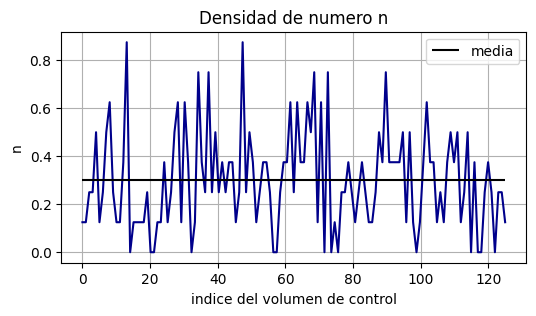

In [ ]:
x_nmic = np.linspace(0,int(L/dl)**3,len(n_mic)) # indices volumenes ctrl

# grafica comparacion densidad global-volumenes de ctrl
fig = plt.figure(figsize =(6,3))
plt.title('Densidad de numero n')
plt.plot(x_nmic, n_mic, 'darkblue')
plt.hlines(np.mean(n_mic), 0,int(L/dl)**3, 'k', label ='media')
plt.xlabel('indice del volumen de control')
plt.ylabel('n')
plt.legend()
plt.grid()

##  **Histograma de rapideces**

5. Calcular la rapidez de cada partícula y hacer un histograma de las rapideces. Comparar el histograma resultante con la distribución de Maxwell-Boltzmann:

$$
f(v) =4πv^2\left[\frac{m}{2 \pi k_B T}\right]^{\frac{3}{2}} \exp \left(-\frac{m v^2}{2 k_B T}\right)
$$

In [ ]:
# dominio de rapideces para la distribucion
v = np.linspace(0,6,100)

# Funcion distribucion Maxwell-Boltzmann
distri_MB = 4*np.pi*v**2*(m_a/(2*np.pi*Kb_canon*T))**(3/2)* \
            np.exp(-m_a*v**2/(2*Kb_canon*T))

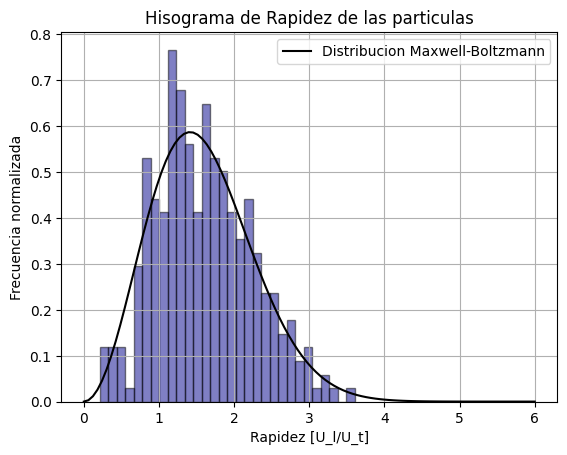

In [ ]:
# Histograma
plt.title('Hisograma de Rapidez de las particulas')
plt.hist(rapid, bins=30, density=True, alpha=0.5,
         color='darkblue', edgecolor='k')
plt.plot(v, distri_MB, 'k', label='Distribucion Maxwell-Boltzmann')
plt.ylabel('Frecuencia normalizada')
plt.xlabel('Rapidez [U_l/U_t]')
plt.legend()
plt.grid()
plt.show()

La forma del histograma tiende a ajustarse a la curva de la distribucion Maxwell-Boltzmann a medida que el numero de particulas aumenta. por ejemplo con mil o mas de mil particulas, el histograma se ajusta muy bien a la distribucion, por cuestiones de tiempo de computo se eligio un numero menor de particulas.  

Se podria afirma que la opercion magnitud (raiz de suma de cuadrados) sobre 3 conjuntos de datos (las componentes de velocidad) que siguen una distribucion normal, hace que el resultado de esta siga una distribucion del tipo Maxwell Boltzmann.

## **Movimiento de las particulas**


7. Simular el movimiento de las partículas del gas así:

   - Por cada paso de tiempo modificar la posición de las partículas con la velocidad que cada una tenga en un momento dado.

   - Si una partícula se sale por un lado de la caja la partícula debe volver a la caja reflejándose en la pared. Para esto puede simplemente dejar la partícula donde estaba y cambiar el signo de la componente de la velocidad en dirección perpendicular a la superficie de la pared.

   - En cada paso de tiempo, y por cada partícula, determinar cuál de las demás partículas de la caja esta más cerca. Si la distancia a la que se encuentra la otra partícula es menor que $f_d L_{mol}$, donde $f_d=10$ asumiremos que las dos partículas chocan y calcularemos el resultado del choque elástico entre ellas. Puede modificar el parámetro $f_d$ de acuerdo a los resultados.

   - Modifique las velocidades de las partículas cada vez que haya un choque usando la rutina (Adaptada de un código por Alejandro Murillo González)

Para el paso de tiempo se tomó una fraccion de dt = 0.1  de la unidad canonica de tiempo.

**El criterio para que las particula golpera las paredes** y no se escaparan del volumen fue el siguiente:
se tomó cada uno de los 3 ejes por separado, si la componente de la particula alcanzaba alguno de sus extremos mas un radio medio de hidrogeno en unidades canonicas $[0+R_h,10-R_h]$ existia contacto, esto evita que las particulas se salgan de la caja cuando su radio hipotetico alcanzara el limite de las paredes. Para este caso se usaron de nuevo boolean mask sobre la posicion delas particulas para obtener en un dt cuantas particulas chocaban contra las paredes.y para el rebote de las particulas, como la unica componente que cambia en el impacto contra cualquier pared es la componente perpendicular a esta, bastaba con cambiar el signo de tal componente cuando la particula llegara al limite de la pared. <br>

**El impacto paricula-particula**:
Debido a que el punto de contacto entre 2 particulas se definio a una distancia $f_d L_{mol}$ se asumió este valor como el doble del radio o el diametro de las particulas (puede que esta distancia dependa de otras fuerzas que intervienen a esas escalas para las particulas, pero por cuestiones de visualizacion se decidio tomar como el radio, para evidenciar el choque, y ademas como se empleó el metodo `Circle` de `matplotlib` si se tomaba un radio muy pequeño, las particulas casi no se podian observar, por lo que se manipuló $f_d$ para que este radio fuera similar al radio medio del hidrogeno pero levemente mayor) <br>
Por su parte, para generar esta interaccion particula-particula, se hizo uso de un doble ciclo sobre todas particulas, junto con un condicional que evita que la distancia entre particulas se menor que $2R=f_d L_{mol}$
<br><br>

**Funcion colision particula-particula:**
  



In [ ]:
def colision(r1,r2,v1,v2):
 """
 Calcula velocidades de 2 partículas después de colisión elástica.
  input:  r1, r2: vectores posición iniciales (arrays)
          v1, v2: vectores velocidad iniciales (arrays)
  output: v1f, v2f: nuevos vectores velocidad
  - Adaptado de un código por Alejandro Murillo González -
 """
 r = r1-r2
 n = r/np.linalg.norm(r)

 vrel = v1-v2

 vn = (vrel@n)*n
 v1f = v1-vn
 v2f = v2+vn

 return v1f, v2f

## **Presion**

8. Para un momento dado calcule la **presión que ejercen las partículas sobre cada una de las parede de la caja.** Para ello sume los cambios en los momentos lineales que sufren las partículas al golpear y divida por el passo del tiempo que está usando en la simulación. <br>

- Compare la presión calculada con la densidad de energía cinética.  <br>

- También compare la presión obtenida con aquella que se espera a partir de la ecuación de estado de gas ideal.<br><br>


Dado que la presion numerica se calcula dentro de la evolucion del sistema, este punto se realizó conjuntamente al anterio, y la presion teorica se calculó despues de la evolucion para compararlas.<br><br>

#### **Presion Numerica:**

Partiendo del momento lineal para las particulas $\vec{P}=m_a \vec{v}$, el cambio en el momento debido a la colision contra una pared será $dP=m_a v_{i}-m_a v_{-i}=2 m_a v_{i}$, donde $iϵ[x,y,z]$, pues en el impacto particula-pared, el unico cambio en la velocidad se dá en la direccion perpendicular a la pared impactada, las otras componentes no cambian en direccion por lo que su cambio es nulo, suponiendo en todos los casos que la magnitud tampoco cambia. En este sentido, en lugar de crear otro subvolumen de control por cada pared del cubo para contar las particulas que colisionaban en un intervalo de tiempo $dt$, se tomó el mismo criterio con boolean mask para el numero de particulas que chocaban contra las paredes. finalmente se sumó el valor absoluto de todos los dambios $dP$ y usando $dP/dt/dA$ se obtuvo la presion numerica ejercida a las paredes.

### **Parametros para la Evolucion del sistema de Particulas**

In [ ]:
# se re-define vector estado (por si se desea reiniciar la animacion)
r = pos
v = vel

# Parametros de Interaccion particula-particula
fd = 0.126      # factor de escala radial
R = fd*L_mol/2  # "radio" de las particulas

# parametros temporales para la evolucion del sistema
dt = 0.1      # paso de tiempo [U_t]
ts = 1000     # tiempo total [U_t]
frams = ts/dt # numero de frames

# vectores para guardar la evolucion del sistema (para simulacion 3d)
rs = np.zeros((ts, r.shape[0], r.shape[1]))
vs = np.zeros((ts, v.shape[0], v.shape[1]))
rs[0] = r.copy() # condiciones iniciales
vs[0] = v.copy()


# limites de cada pared
lim_i = 0 + R_ideal # inicial + radio h
lim_f = L - R_ideal # final + radio h


# parametros para presion numerica
ti_specific = int(ts/2) # tiempo particular (cualquiera)
dA = 6*L**2             # area total de las paredes [U_l^2]

### **Evolucion del sistema de Particulas**

In [ ]:
# Creacion de la figura 2d
fig, ax = plt.subplots()
cam = Camera(fig)

plt.title('Particulas de gas')
ax.set_xlabel('x [U_l]')
ax.set_ylabel('y [U_l]')
ax.set_xlim(0, 10)
ax.set_ylim(0, 10)
plt.axis('equal')
plt.grid()


for t_i in tqdm(range(ts)): # Evolucion temporal del sistema

  # Rebote en paredes (con boolean mask)
  v[r[:,0]<lim_i, 0] = -v[r[:,0]<lim_i, 0] # golpeando paredes extremas en x
  v[r[:,0]>lim_f, 0] = -v[r[:,0]>lim_f, 0]
  v[r[:,1]<lim_i, 1] = -v[r[:,1]<lim_i, 1] # golpeando paredes extremas en y
  v[r[:,1]>lim_f, 1] = -v[r[:,1]>lim_f, 1]
  v[r[:,2]<lim_i, 2] = -v[r[:,2]<lim_i, 2] # golpeando paredes extremas en z
  v[r[:,2]>lim_f, 2] = -v[r[:,2]>lim_f, 2]


  if t_i == ti_specific: # para un tiempo dado
    # las particulas que rebotan son las que contribuyen al cambio de P
    v_xi = v[r[:,0]<lim_i, 0] # impacto en paredes extremas en x
    v_xf = v[r[:,0]>lim_f, 0]
    v_yi = v[r[:,1]<lim_i, 1] # impacto en paredes extremas en y
    v_yf = v[r[:,1]>lim_f, 1]
    v_zi = v[r[:,2]<lim_i, 2] # impacto en paredes extremas en z
    v_zf = v[r[:,2]>lim_f, 2]

    # Suma de los cambios en el momento
    dP = 2*m_a*(sum(np.abs(v_xi)) + sum(np.abs(v_xf)) +
                sum(np.abs(v_yi)) + sum(np.abs(v_yf)) +
                sum(np.abs(v_zi)) + sum(np.abs(v_zf)) )

    # Presion total sobre las paredes
    p = dP/dt/dA


  # Choque elastico de particulas
  for i in range(N):
    for j in range(N):
      if i!=j and i<j:

        # distancia entre particulas
        r_ij = ( (r[i][0]-r[j][0])**2+
                 (r[i][1]-r[j][1])**2+
                 (r[i][2]-r[j][2])**2 )**0.5

        if r_ij <= 2*R: # condicion de contacto
          v[i], v[j] = colision(r[i],r[j],v[i],v[j]) # nueva velocidad


  # para animacion 2D [x,y]
  circle = [Circle(center, radius=R, color='blue') for center in r[:,:2] ]
  ax.add_collection( PatchCollection(circle) )

  r = r + v*dt # movimiento lineal

  rs[t_i] = r.copy() # adicional para grafica 3d
  vs[t_i] = v.copy()

  cam.snap() # captura frame

plt.close()

100%|██████████| 1000/1000 [02:32<00:00,  6.56it/s]


* Es posible que el calculo de choque de particula-particula se pueda hacer mas eficiente sustituyendo los ciclos y los condicioneales por una lista que realice combinatoria sobre los indices de cada particula, con la libreria `from itertools import combinations`

* la idea anterior mas la La forma de graficacion de circulos de un determinado radio en matplotlib se tomó de: Recuperado de: https://github.com/lukepolson/youtube_channel/blob/main/Python%20Metaphysics%20Series/vid28.ipynb

<br><br>

#### **Presion Teorica**<br>

> Del Modelo de **Bernoulli:**
$$ P = \frac{ρ}{3} v_{mol}^2$$
>
> De la ecuacion de estado de los **gases ideales**:
$$ P =  n K_B T$$


Reordando la relacion entre presion y densidad de energia cinetica:
$p = \frac{2}{3}n <k>$

Todos los valores de las presiones obtenidos y mostrados a continuacion estan en unidades canonicas


In [ ]:
# Presion teorica [U_m/(U_m*U_t^2)]
p_bernoulli = rho*v_mol**2/3  # Bernoulli
p_GI = n*Kb_canon*T           # Gases Ideales

# Presiones obtenidas [U_m/(U_m*U_t^2)]
print(f'presion por bernoulli: {p_bernoulli:.4f}')
print(f'presion por gases ideales: {p_GI:.4f}')
print(f'presion numerica: {p:.4f}')
print(f'presion (con densidad de energia cinetica): {2/3*densidad_k:.4f}')

presion por bernoulli: 0.3000
presion por gases ideales: 0.3000
presion numerica: 0.2125
presion (con densidad de energia cinetica): 0.2992


#### **Comparacion Presiones Teoricas y Numerica**



In [ ]:
# Error Relativo
error_p_ND = np.abs(p - 2/3*densidad_k)/(2/3*densidad_k) # numeric - <n>k
error_p_NT = np.abs(p - p_GI)/(p_GI)                     # numeric - teoric
error_p_TD = np.abs(2/3*densidad_k-p_GI)/(p_GI)          # teoric - <n>k

print(f'Error relativo en presion (numerica-densidad k): {error_p_ND:.4f}')
print(f'Error relativo en presion (numerica-teorica): {error_p_NT:.4f}')
print(f'Error relativo en presion (teorica-densidad k): {error_p_TD:.4f}')

Error relativo en presion (numerica-densidad k): 0.2896
Error relativo en presion (numerica-teorica): 0.2915
Error relativo en presion (teorica-densidad k): 0.0027


Se encontró que los valores de la presiones teoricas (Bernoulli y Gases ideales) no coinciden en gran medida con la presion numerica, fenomeno que se podria explicar debido a que la presion numerica solo se calculo para un particular dt, similarmente a los volumenes de control, puede que si se tome el promedio sobre todo insante de tiempo de la evolucion, el valor de la presion numerica se acerque mas al teorico. Pues en un solo instante aleatorio se puede dar un amplio rango de presiones, puede que justo en ese momento el numero de impactos sea menor o mayor, lo cual afecta el resultado de la presion numerica sobre las paredes. <br>

Mientras que la presion teorica comparada con la densidad de energia cinetica si parece tener mas relacion, reafirmando la dependencia que tiene el valor de la presion con la energia cinetica.

<br><br>

<br>

#### **Visualizacion $2D$ del Sistema**

Se tomó el plano $[x,y]$ arbitrariamente

In [ ]:
# animacion
anim_2d = cam.animate(interval=40)  # inverval [ms] de espera por frame
HTML(anim_2d.to_html5_video()) # otro formato to_jshtml()

*Note* que algunas particulas chocan y otras parecen "atravesarse", esto se debe porque en este caso solo se observa una proyeccion $2d$ $[x,y]$ del volumen $[x,y,z]$ en el que se pueden mover las particulas.<br>

<!-- *Nota:* tiempo animacion = Numero de frames * interval [milisegundos] -->

#### **Visualizacion $3D$ del Sistema**

In [ ]:
def animacion3d(frame):
    ax.clear() # limpia grafico previo

    ax.scatter(rs[frame, :, 0],
               rs[frame, :, 1],
               rs[frame, :, 2],
               c='b', marker='o')

    ax.set_title('Particulas de gas en volumen')
    ax.set_xlim3d([0, 10])
    ax.set_ylim3d([0, 10])
    ax.set_zlim3d([0, 10])

    ax.set_xlabel('x [U_l]')
    ax.set_ylabel('y [U_l]')
    ax.set_zlabel('z [U_l]')


# Configura grafica 3d
fig = plt.figure(figsize=(8, 5))
ax = fig.add_subplot(111, projection='3d')
ax.set_title('Particulas de gas')
plt.close()

# Crea la animación
num_frames = rs.shape[0]
anim3d = animation.FuncAnimation(fig, animacion3d, frames=num_frames,
                                 interval=40, repeat=True)

# Muestra la animacion en el notebook
rc('animation', html='jshtml')
anim3d

<br>

* Para la animacion se tomó la libreria `animation.FuncAnimation`
Recuperado de: Animating a 3D scatterplot with Matplotlib. https://medium.com/@pnpsegonne/animating-a-3d-scatterplot-with-matplotlib-ca4b676d4b55

* Para evitar el warning generado por que el tamaño de la animacion supero los 20mb limites, se podria solucionar cambiando el tamaño en [mb] limite, usando por ejemplo:
`plt.rcParams['animation.embed_limit'] = 256 # en [mb]`
O guardando la animacion y luego viendola en otro programa diferente.

* Las lineas finales del uso de la libreria `matplotlib.rc` de "run and config" que desconocia y parte del como usar la funcion `FuncAnimation` se tomó gracias a `Microsoft bing`


<br>



9. **(Opcional)** Utilizando su modelo puede hacer experimentos interesantes:
  - Expansión libre: Divida la caja en dos con un tabique virtual en la mitad. Inicialice las posiciones y velocidades en solo una mitad de la caja, siguiendo las recomendaciones de este punto. Practique ahora un agujero cuadrado de lado $L/10$ (asegúrese que el agujero no sea más pequeño que $L_{mol}$) en la mitad de la pared. Ahora las partículas chocan contra las paredes y contra el tabique, excepto en el punto del agujero. Corra la simulación permitiendo que las partículas pasen de un lado al otro de la caja hasta que note que toda la caja se ha llenado de partículas. Calcule la densidad y la presión (usando la densidad de energía cinética) al final. Compárela con la que se espera de la teoría de expansión libre de un gas en termodinámica (ver una teoría básica [en este enlace](https://en.wikipedia.org/wiki/Joule_expansion#Ideal_gases)).

  - Proceso adiabático: Simule el movimiento de las partículas mientras va moviendo una de las paredes de la caja hacia adentro. Para ello cada 100 pasos de tiempo desplace la pared hacia adentro 1/10 de $L$.  Repita el proceso hasta que la pared este bien adentro (lo ideal es hasta llegar a $L/2$). Detenga la pared y deje que pasen suficientes pasos de tiempo (otros 100 pasos por ejemplo). Determine la temperatura final del gas (usando la RMS de la rapidez), la densidad y la presión (usando la densidad de energía cinética). Compare su resultado con lo esperado en termodinámica para un proceso de compresión adiabática (ver una teoría básica en [en este enlace](https://en.wikipedia.org/wiki/Adiabatic_process#Ideal_gas_(reversible_process)))



**Resultados esperados**:

- Este notebook con el procedimiento debidamente comentado.

- Gráficos mínimos:
  - Gráfico de la posición inicial de las partículas en 2 dimensiones.
  - Gráfico del histograma de rapideces comparado con la distribución de Maxwell-Boltzmann.

- Datos mínimos:
  - Valores de densidad de número, densidad de masa, densidad de energía cinética, presión calculada numéricamente, presión esperada de acuerdo a la ecuación de estado.

- Gráficos opcionales:
  - Animación del movimiento de las partículas.

- **Importante**: En caso de utilizar ayudas como `ChatGPT` o códigos de `Stack Over Flow` debe citar debidamente la fuente, pero también entender a cabalidad el código, el profesor puede pedir justificación.